In [1]:
from datetime import datetime 
import random
from tqdm import tqdm
from PIL import Image
from pathlib import Path
from patchify import patchify
import glob
import cv2
import os
import os.path
import numpy as np
from PIL import Image
from matplotlib import pyplot as plt

import tensorflow as tf
import segmentation_models as sm
import keras 
from keras.utils import normalize
from keras.metrics import MeanIoU

from sklearn.preprocessing import MinMaxScaler, StandardScaler

np.random.seed(42)

Segmentation Models: using `keras` framework.


In [2]:
# Now replace RGB to integer values to be used as labels.
#Find pixels with combination of RGB for the above defined arrays...
#if matches then replace all values in that pixel with a specific integer
def gray_to_idx(label):
    
    vegetation = 170
    tidalflat = 147
    water = 88
    road = 90
    """
    Suply our labale masks as input in RGB format. 
    Replace pixels with specific RGB values ...
    """
    label = np.expand_dims(label, axis=2)
    label_seg = np.zeros(label.shape,dtype=np.uint8)
    
    #np.where(np.all(label == vegetation, axis=-1), 0, label)
    #np.where(np.all(label == tidalflat, axis=-1), 1, label)
    #np.where(np.all(label == water, axis=-1), 2, label)
    #np.where(np.all(label == road, axis=-1), 3, label)
    
    label_seg [np.all(label==vegetation, axis=-1)] = 0
    label_seg [np.all(label==tidalflat, axis=-1)] = 1
    label_seg [np.all(label==water, axis=-1)] = 2
    label_seg [np.all(label==road, axis=-1)] = 3
    
    label_seg = label_seg[:,:,0]  #Just take the first channel, no need for all 3 channels
    
    return label_seg  #label

# Now replace integer to RGB values to be used as labels.
#Find pixels with certain integer value for the above defined values...
#if matches then replace the value in that pixel with a specific RGB

def idx_to_rgb(label):
    
    vegetation = 0
    tidalflat = 1
    water = 2
    road = 3
    
    vegetation_RGB = np.array([50, 255, 50])
    tidalflat_RGB = np.array([255, 120, 0])
    water_RGB = np.array([0, 100, 255])
    road_RGB = np.array([155, 75, 0])
    """
    Suply our labale masks as input in RGB format. 
    Replace pixels with specific RGB values ...
    """
    label = np.expand_dims(label, axis=2)
    label_seg = np.zeros((label.shape[0],label.shape[1],3),dtype=np.uint8)
    label_seg [np.all(label == vegetation,axis=-1)] = vegetation_RGB
    label_seg [np.all(label==tidalflat,axis=-1)] = tidalflat_RGB
    label_seg [np.all(label==water,axis=-1)] = water_RGB
    label_seg [np.all(label==road,axis=-1)] = road_RGB
    
    return label_seg

## Section 1: Data Preparation

(3000, 4000)
labels are:  [ 90 147 170]  and the counts are:  [1489483 3639617 6870900]


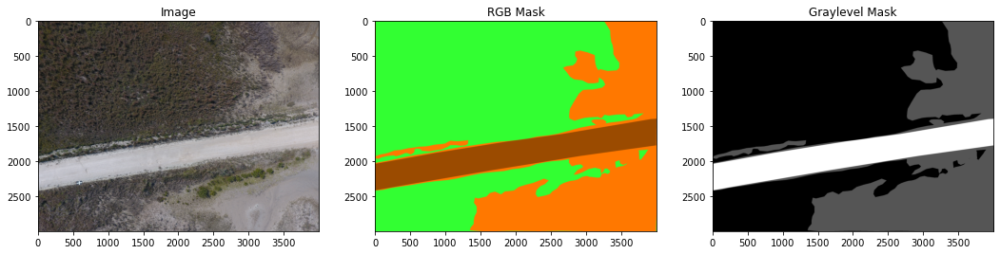

labels are:  [0 1 3]  and the counts are:  [6870900 3639617 1489483]


In [5]:
# Get an understanding by looking at a few random images and masks 
train_img_dir = "./MUI dataset/images/"
train_mask_dir = "./MUI dataset/masks/"

img_list = os.listdir(train_img_dir)
msk_list = os.listdir(train_mask_dir)

num_images = len(os.listdir(train_img_dir))

img_num = random.randint(0, num_images-1)

img_for_plot = cv2.imread(train_img_dir+img_list[img_num], 1)
img_for_plot = cv2.cvtColor(img_for_plot, cv2.COLOR_BGR2RGB)

mask_for_plot = cv2.imread(train_mask_dir+msk_list[img_num], 1) # in case that mask is graylevel image: cv2.imread(train_mask_dir+msk_list[img_num], 0)
mask_for_plot_rgb = cv2.cvtColor(mask_for_plot, cv2.COLOR_BGR2RGB)
mask_for_plot_gray = cv2.cvtColor(mask_for_plot, cv2.COLOR_BGR2GRAY)

print(mask_for_plot_gray.shape)

mask_for_plot_gray = np.array(mask_for_plot_gray)
labels, count = np.unique(mask_for_plot_gray, return_counts = True)
print("labels are: ", labels, " and the counts are: ", count)
mask_for_plot_idx = gray_to_idx(mask_for_plot_gray)


plt.figure(figsize=(18, 8))
plt.subplot(131)
plt.imshow(img_for_plot)
plt.title('Image')
plt.subplot(132)
plt.imshow(mask_for_plot_rgb)  # for graylevel mask images: plt.imshow(mask_for_plot, cmap='gray')
plt.title('RGB Mask')
plt.subplot(133)
plt.imshow(mask_for_plot_idx,cmap='gray')  # for graylevel mask images: plt.imshow(mask_for_plot, cmap='gray')
plt.title('Graylevel Mask')
plt.show()

labels, count = np.unique(mask_for_plot_idx, return_counts = True)
print("labels are: ", labels, " and the counts are: ", count)
#cv2.imwrite("C:/Users/mpashaei/Desktop/Test.jpg", mask_for_plot_idx)

In [6]:
patch_size = 256
root_directory = 'E:/Data/Image Segmentation Project/MUI Dataset/'

In [29]:
#Read images from repsective 'images' directory
image_dataset = []  
for path, subdirs, files in os.walk(root_directory+'MUI_images/'):
    print(path)  
    dirname = path.split(os.path.sep)[-1]
   
    images = os.listdir(path)  #List of all image names in this subdirectory
    for i, image_name in enumerate(images):  
        if image_name.endswith(".JPG"):
            name = Path(image_name).stem
            image = cv2.imread(path+"/"+image_name, 1)  #Read each image as BGR
            # Conver BGR to RGB
            image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
            # Convert BGR to HSV
            #image = cv2.cvtColor(image,cv2.COLOR_BGR2HSV)
            SIZE_X = (image.shape[1]//patch_size)*patch_size #Nearest size divisible by our patch size
            SIZE_Y = (image.shape[0]//patch_size)*patch_size #Nearest size divisible by our patch size
            image = Image.fromarray(image)
            image = image.crop((0 ,0, SIZE_X, SIZE_Y))  #Crop from top left corner
            #image = image.resize((SIZE_X, SIZE_Y))  #Try not to resize for semantic segmentation
            image = np.array(image)             
            #Extract patches from each image
            print("Now patchifying image:", path+"/"+image_name)
            patches_img = patchify(image, (patch_size, patch_size, 3), step=patch_size//2)  #Step=256 for 256 patches means no overlap
            print("patches_img shape: ", patches_img.shape)
            for i in range(patches_img.shape[0]):
                for j in range(patches_img.shape[1]):
                    single_patch_img = patches_img[i,j,:,:,:,:]
                    print("single_patch_img shape: ", single_patch_img.shape)
                        
                    #Use minmaxscaler instead of just dividing by 255. 
                    #single_patch_img = scaler.fit_transform(single_patch_img.reshape(-1, single_patch_img.shape[-1])).reshape(single_patch_img.shape)
                        
                    #single_patch_img = (single_patch_img.astype('float32')) / 255. 
                    single_patch_img = single_patch_img[0] #Drop the extra unecessary dimension that patchify adds. 
                    print("After dropping extra dimension single_patch_img shape: ", single_patch_img.shape)
                        
                    # Patch images can be directly saved on disk or stacked on memory to create a dataset
                    # Save on disk
                    cv2.imwrite(root_directory+"256_patches/images/"+name+'_'+str(i)+"_"+str(j)+".png", single_patch_img)
                    # Stack on memory
                    #image_dataset.append(single_patch_img) 

E:/Data/Image Segmentation Project/MUI Dataset/images/
Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0001.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0006.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0009.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0011.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0013.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0023.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0029.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0031.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0037.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0038.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0043.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0056.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0062.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0063.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0070.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0089.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0093.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0095.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0108.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0128.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0130.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0172.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0181.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0256.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0257.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0502.JPG
patches_img s

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0506.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0509.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0511.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0516.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0518.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0551.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0554.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0618.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0619.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/images//DJI_0624.JPG
patches_img shape:  (21, 29, 1, 256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 256, 3)
single_patch_img shape:  (1, 256, 256, 3)
After dropping extra dimension single_patch_img shape:  (256, 

In [30]:
#Read masks from repsective 'masks' directory
mask_dataset = []  
for path, subdirs, files in os.walk(root_directory+'MUI_masks/'):
    print(path)  
    dirname = path.split(os.path.sep)[-1]
   
    masks = os.listdir(path)  #List of all image names in this subdirectory
    for i, mask_name in enumerate(masks):  
        if mask_name.endswith(".png"):
            name = Path(mask_name).stem
            mask = cv2.imread(path+"/"+mask_name, 1)  #Read each RGB mask as BGR
            # We need greylevel masks not RGB for training, So we convert BGR masks to greylevel
            mask = cv2.cvtColor(mask,cv2.COLOR_BGR2GRAY)
            
            mask = gray_to_idx(mask)
            
            SIZE_X = (mask.shape[1]//patch_size)*patch_size #Nearest size divisible by our patch size
            SIZE_Y = (mask.shape[0]//patch_size)*patch_size #Nearest size divisible by our patch size
            mask = Image.fromarray(mask)
            mask = mask.crop((0 ,0, SIZE_X, SIZE_Y))  #Crop from top left corner
            #image = image.resize((SIZE_X, SIZE_Y))  #Try not to resize for semantic segmentation
            mask = np.array(mask)
            #Extract patches from each image
            print("Now patchifying image:", path+"/"+mask_name)
            patches_msk = patchify(mask, (patch_size, patch_size), step=patch_size//2)  #Step=256 for 256 patches means no overlap
            print("patches_img shape: ", patches_msk.shape)
            for i in range(patches_msk.shape[0]):
                for j in range(patches_msk.shape[1]):
                    single_patch_msk = patches_msk[i,j,:,:]
                    print("single_patch_img shape: ", single_patch_msk.shape)
                        
                    #Use minmaxscaler instead of just dividing by 255. 
                    #single_patch_img = scaler.fit_transform(single_patch_img.reshape(-1, single_patch_img.shape[-1])).reshape(single_patch_img.shape)
                        
                    #single_patch_img = (single_patch_img.astype('float32')) / 255. 
                    #single_patch_msk = single_patch_msk[0] #Drop the extra unecessary dimension that patchify adds. Applicable just for RGB masks 
                    print("After dropping extra dimension single_patch_img shape: ", single_patch_msk.shape)
                        
                    # Patch images can be directly saved on disk or stacked on memory to create a dataset
                    # Save on disk
                    cv2.imwrite(root_directory+"256_patches/masks/"+name+'_'+str(i)+"_"+str(j)+".png", single_patch_msk)
                    
                    # Stack on memory
                    #mask_dataset.append(single_patch_msk) 

E:/Data/Image Segmentation Project/MUI Dataset/masks/
Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0001.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0006.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0008.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0010.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
Now pa

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0014.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0016.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0020.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0023.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0024.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0025.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0026.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0027.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0028.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0029.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0030.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0031.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0033.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0035.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0036.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0037.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0038.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0040.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0043.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0045.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0056.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0057.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0058.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0059.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0060.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0061.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0064.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0066.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0067.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0070.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0076.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0078.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0080.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0082.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0088.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0089.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0090.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0091.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0092.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0094.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0096.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0097.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0100.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0102.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0104.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0108.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0110.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/mas

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0118.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0121.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0123.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0126.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0128.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0130.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0134.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0137.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0144.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0147.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0156.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0172.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0174.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0177.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0181.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0186.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0197.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0199.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0254.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0256.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0257.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0304.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0305.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0306.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0317.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0318.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0319.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0443.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0444.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0445.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0502.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0504.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0509.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0511.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0514.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0516.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0518.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0520.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0541.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0543.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0549.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0551.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0554.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0555.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0558.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0560.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0609.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0614.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0616.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/mas

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0624.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0626.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

Now patchifying image: E:/Data/Image Segmentation Project/MUI Dataset/masks//DJI_0628.png
patches_img shape:  (21, 29, 256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropp

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single_patch_img shape:  (256, 256)
single_patch_img shape:  (256, 256)
After dropping extra dimension single

In [14]:
labels, count = np.unique(mask_dataset, return_counts = True)
print("labels are: ", labels, " and the counts are: ", count)

labels are:  [0 1 2 3]  and the counts are:  [2674296851 1798786532  522369071  232944090]


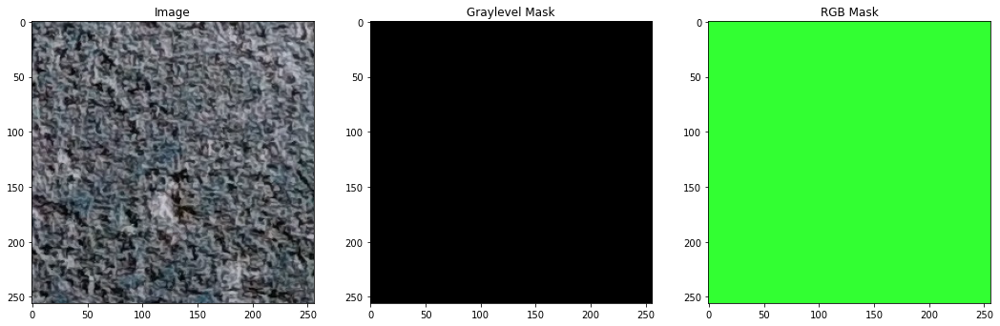

labels are:  [0]  and the counts are:  [65536]


In [9]:
train_img_dir = root_directory + "256_patches/images/"
train_mask_dir = root_directory + "256_patches/masks/"

img_list = os.listdir(train_img_dir)
msk_list = os.listdir(train_mask_dir)
num_images = len(os.listdir(train_img_dir))

img_num = random.randint(0, num_images-1)
img_for_plot = cv2.imread(train_img_dir+img_list[img_num], 1)
img_for_plot = cv2.cvtColor(img_for_plot,cv2.COLOR_BGR2RGB)

mask_for_plot = cv2.imread(train_mask_dir+msk_list[img_num], 0) # 0 because masks are greylevel images

# We can convert greylevel masks back to RGB
mask_for_plot_rgb = idx_to_rgb(mask_for_plot)

plt.figure(figsize=(18, 8))
plt.subplot(131)
plt.imshow(img_for_plot)
plt.title('Image')
plt.subplot(132)
plt.imshow(mask_for_plot,cmap='gray')  # for graylevel mask images: plt.imshow(mask_for_plot, cmap='gray')
plt.title('Graylevel Mask')
plt.subplot(133)
plt.imshow(mask_for_plot_rgb)  # for graylevel mask images: plt.imshow(mask_for_plot, cmap='gray')
plt.title('RGB Mask')
plt.show()

labels, count = np.unique(mask_for_plot, return_counts = True)
print("labels are: ", labels, " and the counts are: ", count)

In [ ]:
###########################################################################

#Now, let us copy images and masks with real information to a new folder.
# real information = if mask has decent amount of labels other than 0. 

useless=0  #Useless image counter
for img in range(len(img_list)):   #Using t1_list as all lists are of same size
    img_name=img_list[img]
    mask_name = msk_list[img]
    print("Now preparing image and masks number: ", img)
      
    temp_image=cv2.imread(train_img_dir+img_list[img], 1)
   
    temp_mask=cv2.imread(train_mask_dir+msk_list[img], 0)
    #temp_mask=temp_mask.astype(np.uint8)
    
    val, counts = np.unique(temp_mask, return_counts=True)
    
    if (1 - (counts[0]/counts.sum())) > 0.05:  #At least 5% useful area with labels that are not 0
        print("Save Me")
        cv2.imwrite('data/256_patches/images_with_useful_info/images/'+img_name, temp_image)
        cv2.imwrite('data/256_patches/images_with_useful_info/masks/'+mask_name, temp_mask)
        
    else:
        print("I am useless")   
        useless +=1

print("Total useful images are: ", len(img_list)-useless)  #20,075
print("Total useless images are: ", useless) #21,571
###############################################################

In [10]:
#Now split the data into training, validation and testing. 
root_directory = 'E:/Data/Image Segmentation Project/MUI Dataset/'

"""
Code for splitting folder into train, test, and val.
Once the new folders are created rename them and arrange in the format below to be used
for semantic segmentation using data generators. 
pip install split-folders
"""
import splitfolders  # or import split_folders

input_folder = root_directory+ '256_patches/'

output_folder = root_directory+'256_patches/data_for_training_and_testing/'


# Split with a ratio.
# To only split into training and validation set, set a tuple to `ratio`, i.e, `(.8, .2)`.
splitfolders.ratio(input_folder, output=output_folder, seed=42, ratio=(.75, .25), group_prefix=None) # default values

Copying files: 159558 files [1:16:58, 34.55 files/s] 


In [ ]:
#Now manually move folders around to bring them to the following structure.
"""
Your current directory structure:
Data/
    train/
        images/
            img1, img2, ...
        masks/
            msk1, msk2, ....
    val/
        images/
            img1, img2, ...
        masks/
            msk1, msk2, ....
        
Copy the folders around to the following structure... 
Data/
    train_images/
                train/
                    img1, img2, img3, ......
    
    train_masks/
                train/
                    msk1, msk, msk3, ......
                    
    val_images/
                val/
                    img1, img2, img3, ......                
    val_masks/
                val/
                    msk1, msk, msk3, ......                    
"""

## Section 2: Training

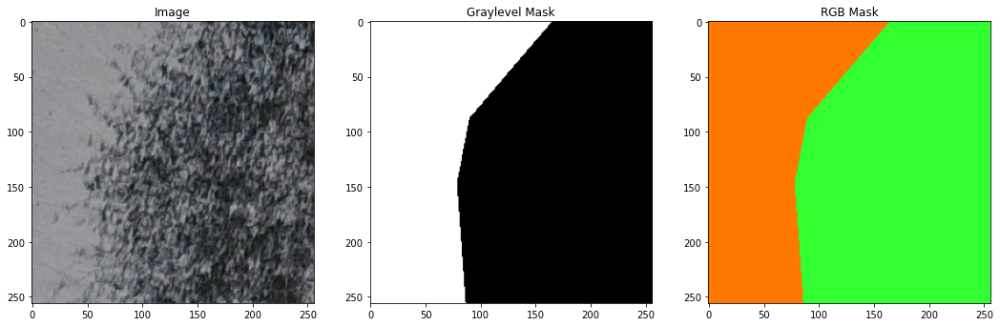

labels are:  [0 1]  and the counts are:  [40340 25196]


In [21]:
train_img_dir = root_directory + "256_patches/data_for_training_and_testing/train_images/train/"
train_mask_dir = root_directory + "256_patches/data_for_training_and_testing/train_masks/train/"

img_list = os.listdir(train_img_dir)
msk_list = os.listdir(train_mask_dir)
num_images = len(os.listdir(train_img_dir))

img_num = random.randint(0, num_images-1)
img_for_plot = cv2.imread(train_img_dir+img_list[img_num], 1)
img_for_plot = cv2.cvtColor(img_for_plot,cv2.COLOR_BGR2RGB)

mask_for_plot = cv2.imread(train_mask_dir+msk_list[img_num], 0) # 0 because masks are greylevel images


# We can convert greylevel masks back to RGB
mask_for_plot_rgb = idx_to_rgb(mask_for_plot)

plt.figure(figsize=(18, 8))
plt.subplot(131)
plt.imshow(img_for_plot)
plt.title('Image')
plt.subplot(132)
plt.imshow(mask_for_plot,cmap='gray')  # for graylevel mask images: plt.imshow(mask_for_plot, cmap='gray')
plt.title('Graylevel Mask')
plt.subplot(133)
plt.imshow(mask_for_plot_rgb)  # for graylevel mask images: plt.imshow(mask_for_plot, cmap='gray')
plt.title('RGB Mask')
plt.show()

labels, count = np.unique(mask_for_plot, return_counts = True)
print("labels are: ", labels, " and the counts are: ", count)

#cv2.imwrite("C:/Users/mpashaei/Desktop/Test.jpg", mask_for_plot)

In [14]:
# Define Generator for images and masks so we can read them directly from the drive. 

seed = 24
batch_size = 64
n_classes = 4

from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
from keras.utils import to_categorical

#Use this to preprocess input for transfer learning
BACKBONE = 'resnet34'
preprocess_input = sm.get_preprocessing(BACKBONE)

#Define a function to perform additional preprocessing after datagen.
#For example, scale images, convert masks to categorical, etc. 
def preprocess_data(img, mask, num_class):
    #Scale images
    img = scaler.fit_transform(img.reshape(-1, img.shape[-1])).reshape(img.shape)
    img = preprocess_input(img)  #Preprocess based on the pretrained backbone...
    
    #Convert mask to one-hot
    mask = to_categorical(mask, num_class)

    return (img,mask)

#Define the generator.
#We are not doing any rotation or zoom to make sure mask values are not interpolated.
#It is important to keep pixel values in mask as 0, 1, 2, 3, .....
from tensorflow.keras.preprocessing.image import ImageDataGenerator
def trainGenerator(train_img_path, train_mask_path, num_class):
    
    img_data_gen_args = dict(horizontal_flip=True,
                      vertical_flip=True,
                      fill_mode='reflect')
    
    image_datagen = ImageDataGenerator(**img_data_gen_args)
    mask_datagen = ImageDataGenerator(**img_data_gen_args)
    
    image_generator = image_datagen.flow_from_directory(
        train_img_path,
        #target_size=(patch_size, patch_size),
        class_mode = None,
        batch_size = batch_size,
        seed = seed)
    
    mask_generator = mask_datagen.flow_from_directory(
        train_mask_path,
        #target_size=(patch_size, patch_size),
        class_mode = None,
        color_mode = 'grayscale',
        batch_size = batch_size,
        seed = seed)
    
    train_generator = zip(image_generator, mask_generator)
    
    for (img, mask) in train_generator:
        img, mask = preprocess_data(img, mask, num_class)
        yield (img, mask)

In [15]:
train_img_path = root_directory + "256_patches/data_for_training_and_testing/train_images/"
train_mask_path = root_directory + "256_patches/data_for_training_and_testing/train_masks/"

train_img_gen = trainGenerator(train_img_path, train_mask_path, num_class=4)

val_img_path = root_directory + "256_patches/data_for_training_and_testing/val_images/"
val_mask_path = root_directory + "256_patches/data_for_training_and_testing/val_masks/"

val_img_gen = trainGenerator(val_img_path, val_mask_path, num_class=4)

Found 59834 images belonging to 1 classes.
Found 59834 images belonging to 1 classes.


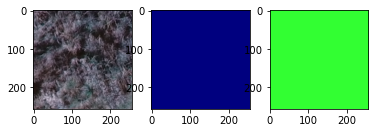

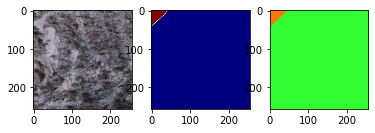

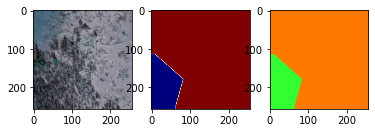

Found 19945 images belonging to 1 classes.
Found 19945 images belonging to 1 classes.


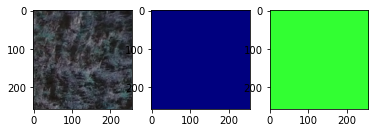

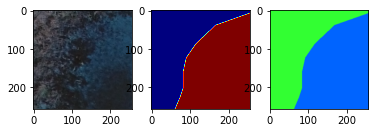

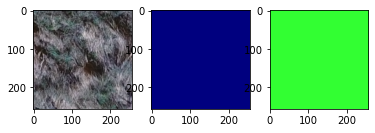

In [16]:
#Make sure the generator is working and that images and masks are indeed lined up. 
#Verify generator.... In python 3 next() is renamed as __next__()
x, y = train_img_gen.__next__()

for i in range(0,3):
    image = x[i]
    mask = np.argmax(y[i], axis=2)
    mask_rgb = idx_to_rgb(mask)
    plt.subplot(1,3,1)
    plt.imshow(image)
    plt.subplot(1,3,2)
    plt.imshow(mask, cmap='jet')
    plt.subplot(1,3,3)
    plt.imshow(mask_rgb)
    plt.show()
    
x_val, y_val = val_img_gen.__next__()

for i in range(0,3):
    image = x_val[i]
    mask = np.argmax(y_val[i], axis=2)
    mask_rgb = idx_to_rgb(mask)
    plt.subplot(1,3,1)
    plt.imshow(image)
    plt.subplot(1,3,2)
    plt.imshow(mask, cmap='jet')
    plt.subplot(1,3,3)
    plt.imshow(mask_rgb)
    plt.show()

In [17]:
num_train_imgs = len(os.listdir(train_img_path+'train/'))
num_val_images = len(os.listdir(val_img_path+'val/'))
steps_per_epoch = num_train_imgs//batch_size
val_steps_per_epoch = num_val_images//batch_size


IMG_HEIGHT = x.shape[1]
IMG_WIDTH  = x.shape[2]
IMG_CHANNELS = x.shape[3]

n_classes=4

In [18]:
# computing class weights for unballanced datasets

from sklearn.utils.class_weight import compute_class_weight

#n_classes = 4
#class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(np.ravel(y_train,order='C')), y=np.ravel(y_train,order='C'))
#class_weights = np.array(class_weights)
class_weights = np.array([0.46414264, 0.75112234, 2.82734849, 6.23206021])
print(class_weights)

[0.46414264 0.75112234 2.82734849 6.23206021]


In [ ]:
'''
# Segmentation models losses can be combined together by '+' and scaled by integer or float factor
# set class weights for dice_loss (car: 1.; pedestrian: 2.; background: 0.5;)
dice_loss = sm.losses.DiceLoss(class_weights=class_weights) 
focal_loss = sm.losses.CategoricalFocalLoss()
total_loss = dice_loss + (1 * focal_loss)

# actulally total_loss can be imported directly from library, above example just show you how to manipulate with losses
# total_loss = sm.losses.binary_focal_dice_loss # or sm.losses.categorical_focal_dice_loss 


metrics = [tf.keras.metrics.MeanIoU(num_classes=n_classes), tf.keras.metrics.Accuracy()]
#metrics = [sm.metrics.IOUScore(class_weights=class_weights, threshold=0.5), sm.metrics.FScore(class_weights=class_weights, threshold=0.5)]

# or make and use our own metrics
from simple_multi_unet_model import multi_unet_model, jacard_coef  

metrics=['accuracy', jacard_coef]

'''


In [22]:
BACKBONE = 'resnet34'
#BACKBONE = 'inceptionv3'
#BACKBONE = 'vgg16'

In [23]:
# Learning rate scheduler

learning_rate = 1e-4

def lr_scheduler(epoch,lr):
    decay_step = 10
    if epoch < 10:
        return lr
    elif (epoch % decay_step) == 0:
        return lr * tf.math.exp(-0.01*epoch/10)
    else:
        return lr

# Model Callbacks
checkpoint_filepath = './checkpoint/Landcover_weight_ResNet34_backbone_50epochs.hdf5'

callbacks = [tf.keras.callbacks.LearningRateScheduler(lr_scheduler),
             tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_filepath, monitor='val_loss',save_weights_only=True, save_best_only=True, mode='max'),
             tf.keras.callbacks.EarlyStopping(patience=10, monitor='val_loss'),
             tf.keras.callbacks.TensorBoard(log_dir='logs')]

optim = keras.optimizers.Adam(learning_rate=learning_rate)

In [24]:
#############################################################################
#Use transfer learning using pretrained encoder in the U-Net
#(make sure you uncomment the preprocess_input part in the
# preprocess_data function above)
################################################################
#Define the model
# define model
model = sm.Unet(BACKBONE, encoder_weights='imagenet', input_shape=(IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS),
                classes=n_classes, activation='softmax')

#model = sm.Linknet(BACKBONE, encoder_weights='imagenet', input_shape=(IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS),
#                   classes=n_classes, activation='softmax')

print(model.summary())
print(model.input_shape)

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 data (InputLayer)              [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 bn_data (BatchNormalization)   (None, 256, 256, 3)  9           ['data[0][0]']                   
                                                                                                  
 zero_padding2d (ZeroPadding2D)  (None, 262, 262, 3)  0          ['bn_data[0][0]']                
                                                                                                  
 conv0 (Conv2D)                 (None, 128, 128, 64  9408        ['zero_padding2d[0][0]']   

 D)                                                                                               
                                                                                                  
 stage1_unit3_conv1 (Conv2D)    (None, 64, 64, 64)   36864       ['zero_padding2d_6[0][0]']       
                                                                                                  
 stage1_unit3_bn2 (BatchNormali  (None, 64, 64, 64)  256         ['stage1_unit3_conv1[0][0]']     
 zation)                                                                                          
                                                                                                  
 stage1_unit3_relu2 (Activation  (None, 64, 64, 64)  0           ['stage1_unit3_bn2[0][0]']       
 )                                                                                                
                                                                                                  
 zero_padd

                                                                                                  
 stage2_unit3_relu2 (Activation  (None, 32, 32, 128)  0          ['stage2_unit3_bn2[0][0]']       
 )                                                                                                
                                                                                                  
 zero_padding2d_13 (ZeroPadding  (None, 34, 34, 128)  0          ['stage2_unit3_relu2[0][0]']     
 2D)                                                                                              
                                                                                                  
 stage2_unit3_conv2 (Conv2D)    (None, 32, 32, 128)  147456      ['zero_padding2d_13[0][0]']      
                                                                                                  
 add_5 (Add)                    (None, 32, 32, 128)  0           ['stage2_unit3_conv2[0][0]',     
          

                                                                                                  
 stage3_unit2_conv2 (Conv2D)    (None, 16, 16, 256)  589824      ['zero_padding2d_19[0][0]']      
                                                                                                  
 add_8 (Add)                    (None, 16, 16, 256)  0           ['stage3_unit2_conv2[0][0]',     
                                                                  'add_7[0][0]']                  
                                                                                                  
 stage3_unit3_bn1 (BatchNormali  (None, 16, 16, 256)  1024       ['add_8[0][0]']                  
 zation)                                                                                          
                                                                                                  
 stage3_unit3_relu1 (Activation  (None, 16, 16, 256)  0          ['stage3_unit3_bn1[0][0]']       
 )        

                                                                                                  
 stage3_unit6_relu1 (Activation  (None, 16, 16, 256)  0          ['stage3_unit6_bn1[0][0]']       
 )                                                                                                
                                                                                                  
 zero_padding2d_26 (ZeroPadding  (None, 18, 18, 256)  0          ['stage3_unit6_relu1[0][0]']     
 2D)                                                                                              
                                                                                                  
 stage3_unit6_conv1 (Conv2D)    (None, 16, 16, 256)  589824      ['zero_padding2d_26[0][0]']      
                                                                                                  
 stage3_unit6_bn2 (BatchNormali  (None, 16, 16, 256)  1024       ['stage3_unit6_conv1[0][0]']     
 zation)  

                                                                                                  
 stage4_unit3_conv1 (Conv2D)    (None, 8, 8, 512)    2359296     ['zero_padding2d_32[0][0]']      
                                                                                                  
 stage4_unit3_bn2 (BatchNormali  (None, 8, 8, 512)   2048        ['stage4_unit3_conv1[0][0]']     
 zation)                                                                                          
                                                                                                  
 stage4_unit3_relu2 (Activation  (None, 8, 8, 512)   0           ['stage4_unit3_bn2[0][0]']       
 )                                                                                                
                                                                                                  
 zero_padding2d_33 (ZeroPadding  (None, 10, 10, 512)  0          ['stage4_unit3_relu2[0][0]']     
 2D)      

                                                                                                  
 decoder_stage2b_bn (BatchNorma  (None, 64, 64, 64)  256         ['decoder_stage2b_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 decoder_stage2b_relu (Activati  (None, 64, 64, 64)  0           ['decoder_stage2b_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 decoder_stage3_upsampling (UpS  (None, 128, 128, 64  0          ['decoder_stage2b_relu[0][0]']   
 ampling2D)                     )                                                                 
                                                                                                  
 decoder_s

In [27]:
model.compile(optimizer=optim, loss=sm.losses.categorical_focal_jaccard_loss, metrics=[sm.metrics.iou_score])
#Other losses to try: categorical_focal_dice_loss, cce_jaccard_loss, cce_dice_loss, categorical_focal_loss

# Or we can make our own loss and metrics
# compile keras model with defined optimozer, loss and metrics
# model.compile(optimizer=optim, loss=total_loss, metrics=metrics)
#model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=metrics)

In [ ]:
#Fit the model
#history = model.fit(my_generator, validation_data=validation_datagen, steps_per_epoch=len(X_train) // 16, validation_steps=len(X_train) // 16, epochs=100)
#Train the model. 

start = datetime.now()

history=model.fit(train_img_gen,
                  steps_per_epoch=steps_per_epoch,
                   #batch_size=2,
                   epochs=20,
                   verbose=1,
                   validation_data=val_img_gen,
                   validation_steps=val_steps_per_epoch,
                   #validation_split=0.1,
                   callbacks=callbacks)

stop = datetime.now()

#Execution time of the model 
execution_time_unet = stop - start
print("UNet execution time is: ", execution_time_unet)

model.save('model weights/Landcover_weight_ResNet34_backbone_50epochs.hdf5')


Epoch 1/20


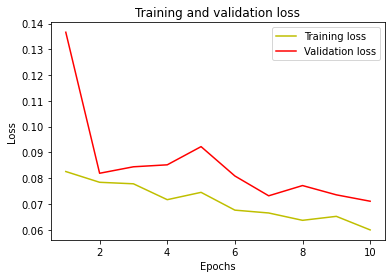

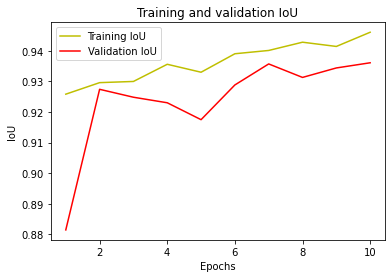

In [26]:
#plot the training and validation IoU and loss at each epoch
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(loss) + 1)
plt.plot(epochs, loss, 'y', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

acc = history.history['iou_score']
val_acc = history.history['val_iou_score']

plt.plot(epochs, acc, 'y', label='Training IoU')
plt.plot(epochs, val_acc, 'r', label='Validation IoU')
plt.title('Training and validation IoU')
plt.xlabel('Epochs')
plt.ylabel('IoU')
plt.legend()
plt.show()

### Application

In [9]:
import glob
import cv2
import os
import os.path
import numpy as np
from pathlib import Path
import tensorflow as tf

from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()

from smooth_tiled_predictions import predict_img_with_smooth_windowing
import segmentation_models as sm

In [2]:
def idx_to_rgb(predicted_image):
    
    vegetation = np.array([50, 255, 50])
    tidalflat = np.array([255, 120, 0])
    water = np.array([0, 100, 255])
    road = np.array([155, 75, 0])
    
    segmented_img = np.empty((predicted_image.shape[0], predicted_image.shape[1], 3))
    
    segmented_img[(predicted_image == 0)] = vegetation
    segmented_img[(predicted_image == 1)] = tidalflat
    segmented_img[(predicted_image == 2)] = water
    segmented_img[(predicted_image == 3)] = road
    #segmented_img[(predicted_image == 4)] = Water
    #segmented_img[(predicted_image == 5)] = Unlabeled
    
    segmented_img = segmented_img.astype(np.uint8)
    return(segmented_img)

In [3]:
#################################################################################
# Predict patch by patch with no smooth blending
###########################################
def predict_no_smooth(img, patch_size):
    
    SIZE_X = (img.shape[1]//patch_size)*patch_size #Nearest size divisible by our patch size
    SIZE_Y = (img.shape[0]//patch_size)*patch_size #Nearest size divisible by our patch size
    large_img = Image.fromarray(img)
    large_img = large_img.crop((0 ,0, SIZE_X, SIZE_Y))  #Crop from top left corner
    #image = image.resize((SIZE_X, SIZE_Y))  #Try not to resize for semantic segmentation
    large_img = np.array(large_img)     


    patches_img = patchify(large_img, (patch_size, patch_size, 3), step=patch_size)  #Step=256 for 256 patches means no overlap
    patches_img = patches_img[:,:,0,:,:,:]

    patched_prediction = []
    for i in range(patches_img.shape[0]):
        for j in range(patches_img.shape[1]):

            single_patch_img = patches_img[i,j,:,:,:]

            #Use minmaxscaler instead of just dividing by 255. 
            single_patch_img = scaler.fit_transform(single_patch_img.reshape(-1, single_patch_img.shape[-1])).reshape(single_patch_img.shape)
            single_patch_img = preprocess_input(single_patch_img)
            
            single_patch_img = np.expand_dims(single_patch_img, axis=0)
            pred = model.predict(single_patch_img)
            pred = np.argmax(pred, axis=3)
            pred = pred[0, :,:]

            patched_prediction.append(pred)

    patched_prediction = np.array(patched_prediction)
    patched_prediction = np.reshape(patched_prediction, [patches_img.shape[0], patches_img.shape[1], 
                                                patches_img.shape[2], patches_img.shape[3]])

    unpatched_prediction = unpatchify(patched_prediction, (large_img.shape[0], large_img.shape[1]))
    
    #plt.imshow(unpatched_prediction)
    #plt.axis('off')
    return unpatched_prediction

In [4]:
#################################################################################
# Predict patch by patch with no smooth blending but considering the original size of the image
###########################################
def predict_no_smooth_original_size(img, patch_size):
    
    final_prediction = np.zeros((img.shape[0], img.shape[1]), dtype=int)
    
    num_patches_X = (img.shape[1]//patch_size)
    num_patches_Y = (img.shape[0]//patch_size) 
    
    y = 0
    
    for r in range(num_patches_Y):
        y += 1
        x = 0
        for c in range(num_patches_X):
            y += 1
            image_patch = img[r*patch_size:(r+1)*patch_size, c*patch_size:(c+1)*patch_size,:]
            print("image patch shape in loop 1: ", image_patch.shape)
            image_patch = scaler.fit_transform(image_patch.reshape(-1, image_patch.shape[-1])).reshape(image_patch.shape)
            image_patch = preprocess_input(image_patch)
            image_patch = np.expand_dims(image_patch, axis=0)
            pred = model.predict(image_patch)
            pred = np.argmax(pred, axis=3)
            pred = pred[0, :,:]
            final_prediction[r*patch_size:(r+1)*patch_size, c*patch_size:(c+1)*patch_size] = pred
        
    X = num_patches_X + 1;
    y = 0;
    for r in range(num_patches_Y):
        y += 1
        image_patch = img[r*patch_size:(r+1)*patch_size, img.shape[1]-patch_size:,:]
        print("image patch shape in loop 2: ", image_patch.shape)
        image_patch = scaler.fit_transform(image_patch.reshape(-1, image_patch.shape[-1])).reshape(image_patch.shape)
        image_patch = preprocess_input(image_patch)
        image_patch = np.expand_dims(image_patch, axis=0)
        pred = model.predict(image_patch)
        pred = np.argmax(pred, axis=3)
        pred = pred[0, :,:]
        final_prediction[r*patch_size:(r+1)*patch_size, img.shape[1]-patch_size:] = pred

    Y = num_patches_Y + 1
    x = 0
    for c in range(num_patches_X):
        x += 1
        image_patch = img[img.shape[0]-patch_size:, c*patch_size:(c+1)*patch_size,:] 
        print("image patch shape in loop 3: ", image_patch.shape)
        image_patch = scaler.fit_transform(image_patch.reshape(-1, image_patch.shape[-1])).reshape(image_patch.shape)
        image_patch = preprocess_input(image_patch)
        image_patch = np.expand_dims(image_patch, axis=0)
        pred = model.predict(image_patch)
        pred = np.argmax(pred, axis=3)
        pred = pred[0, :,:]
        final_prediction[img.shape[0]-patch_size:, c*patch_size:(c+1)*patch_size] = pred
        
    X = num_patches_X + 1
    Y = num_patches_Y + 1
    
    image_patch = img[img.shape[0]-patch_size:,img.shape[1]-patch_size:,:]
    print("image patch shape in loop 4: ", image_patch.shape)
    image_patch = scaler.fit_transform(image_patch.reshape(-1, image_patch.shape[-1])).reshape(image_patch.shape)
    image_patch = preprocess_input(image_patch)
    image_patch = np.expand_dims(image_patch, axis=0)
    pred = model.predict(image_patch)
    pred = np.argmax(pred, axis=3)
    pred = pred[0, :,:]
    final_prediction[img.shape[0]-patch_size:,img.shape[1]-patch_size:] = pred

    return final_prediction

In [11]:
###################################################################################
#Predict using smooth blending
###########################################
def predict_with_smooth(img, patch_size):
    
    input_img = scaler.fit_transform(img.reshape(-1, img.shape[-1])).reshape(img.shape)
    input_img = preprocess_input(input_img)
    
    print(input_img.shape)

    # Use the algorithm. The `pred_func` is passed and will process all the image 8-fold by tiling small patches with overlap, called once with all those image as a batch outer dimension.
    # Note that model.predict(...) accepts a 4D tensor of shape (batch, x, y, nb_channels), such as a Keras model.
    predictions_smooth = predict_img_with_smooth_windowing(
        input_img,
        window_size=patch_size,
        subdivisions=2,  # Minimal amount of overlap for windowing. Must be an even number.
        nb_classes=n_classes,
        pred_func=(
            lambda img_batch_subdiv: model.predict((img_batch_subdiv))
        )
    )

    final_prediction = np.argmax(predictions_smooth, axis=2)
    
    return final_prediction

In [12]:
root_directory = "C:/Users/mpashaei/Desktop/Image Segmentation Project/semantic_segmentation_of_aerial_imagery_using_unet"

In [13]:
BACKBONE = 'resnet34'
patch_size = 256
n_classes = 4

scaler = MinMaxScaler()
preprocess_input = sm.get_preprocessing(BACKBONE)

In [10]:
from keras.models import load_model

#Set compile=False as we are not loading it for training, only for prediction.
with tf.device('/gpu:0'):
    #model = load_model('model weights/res34_backbone_50epochs.hdf5', compile=False)
    #model2 = load_model('saved_models/inceptionv3_backbone_50epochs.hdf5', compile=False)
    model = load_model('model weights/Landcover_weight_ResNet34_backbone_50epochs.hdf5', compile=False)

In [16]:
for path, subdirs, files in os.walk(root_directory):
    dirname = path.split(os.path.sep)[-1]
    if dirname == 'Large Images Prediction':   #Find all 'images' directories
        images = os.listdir(path+'/images/')  #List of all image names in this subdirectory
        for i, image_name in enumerate(images):  
            if image_name.endswith(".JPG"):   #Only read jpg images...
                name = Path(image_name).stem
                img = cv2.imread(path+"/images/"+image_name, 1)  #Read each image as BGR
                                                                 # No need for conversion to RGB
                                                                 # model has been trainded on BGR 
                print(img.shape)
                prediction = predict_with_smooth(img, patch_size)
                
                #prediction = predict_no_smooth_original_size(img, patch_size)
                
                prediction = idx_to_rgb(prediction)
                cv2.imwrite(path + '/predictions/' + name + '_mask.png', cv2.cvtColor(prediction,cv2.COLOR_BGR2RGB))

(3000, 4000, 3)
(3000, 4000, 3)


  0%|          | 0/8 [00:00<?, ?it/s]

24/24 [==============================] - 2s 102ms/step


 12%|█▎        | 1/8 [00:08<00:58,  8.32s/it]

24/24 [==============================] - 2s 101ms/step


 25%|██▌       | 2/8 [00:16<00:49,  8.33s/it]

24/24 [==============================] - 2s 101ms/step


 38%|███▊      | 3/8 [00:24<00:41,  8.25s/it]

24/24 [==============================] - 2s 100ms/step


 50%|█████     | 4/8 [00:33<00:33,  8.33s/it]

24/24 [==============================] - 2s 100ms/step


 62%|██████▎   | 5/8 [00:41<00:24,  8.23s/it]

24/24 [==============================] - 2s 99ms/step


 75%|███████▌  | 6/8 [00:49<00:16,  8.26s/it]

24/24 [==============================] - 2s 99ms/step


 88%|████████▊ | 7/8 [00:58<00:08,  8.36s/it]

24/24 [==============================] - 2s 100ms/step


100%|██████████| 8/8 [01:06<00:00,  8.35s/it]


(3000, 4000, 3)
(3000, 4000, 3)


  0%|          | 0/8 [00:00<?, ?it/s]

24/24 [==============================] - 2s 100ms/step


 12%|█▎        | 1/8 [00:07<00:55,  7.89s/it]

24/24 [==============================] - 2s 100ms/step


 25%|██▌       | 2/8 [00:16<00:48,  8.10s/it]

24/24 [==============================] - 2s 101ms/step


 38%|███▊      | 3/8 [00:24<00:40,  8.18s/it]

24/24 [==============================] - 2s 103ms/step


 50%|█████     | 4/8 [00:32<00:33,  8.30s/it]

24/24 [==============================] - 2s 100ms/step


 62%|██████▎   | 5/8 [00:41<00:24,  8.32s/it]

24/24 [==============================] - 2s 101ms/step


 75%|███████▌  | 6/8 [00:49<00:16,  8.38s/it]

24/24 [==============================] - 2s 101ms/step


 88%|████████▊ | 7/8 [00:57<00:08,  8.31s/it]

24/24 [==============================] - 2s 101ms/step


100%|██████████| 8/8 [01:06<00:00,  8.30s/it]


(3000, 4000, 3)
(3000, 4000, 3)


  0%|          | 0/8 [00:00<?, ?it/s]

24/24 [==============================] - 2s 101ms/step


 12%|█▎        | 1/8 [00:07<00:55,  7.92s/it]

24/24 [==============================] - 2s 101ms/step


 25%|██▌       | 2/8 [00:16<00:49,  8.27s/it]

24/24 [==============================] - 2s 101ms/step


 38%|███▊      | 3/8 [00:24<00:40,  8.18s/it]

24/24 [==============================] - 2s 103ms/step


 50%|█████     | 4/8 [00:33<00:33,  8.39s/it]

24/24 [==============================] - 2s 100ms/step


 62%|██████▎   | 5/8 [00:41<00:24,  8.30s/it]

24/24 [==============================] - 2s 101ms/step


 75%|███████▌  | 6/8 [00:49<00:16,  8.34s/it]

24/24 [==============================] - 2s 100ms/step


 88%|████████▊ | 7/8 [00:57<00:08,  8.24s/it]

24/24 [==============================] - 2s 100ms/step


100%|██████████| 8/8 [01:06<00:00,  8.29s/it]


(3000, 4000, 3)
(3000, 4000, 3)


  0%|          | 0/8 [00:00<?, ?it/s]

24/24 [==============================] - 2s 101ms/step


 12%|█▎        | 1/8 [00:07<00:55,  7.95s/it]

24/24 [==============================] - 2s 100ms/step


 25%|██▌       | 2/8 [00:16<00:49,  8.22s/it]

 8/24 [=========>....................] - ETA: 1s

 25%|██▌       | 2/8 [00:18<00:55,  9.30s/it]


KeyboardInterrupt: 